# Bayesian Repertoire Overlap - Reproduction Notebook

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
from scipy.stats import hypergeom
from scipy.stats import binned_statistic as binsta
from scipy.special import logsumexp
from util import *
import palettable as pal
clrx = pal.cartocolors.qualitative.Prism_10.mpl_colors
clr = tuple(x for n,x in enumerate(clrx) if n in [1,2,4,5,6])
clr2 = pal.cartocolors.sequential.agSunset_7.mpl_colors
import matplotlib.gridspec as gridspec
import matplotlib.patches as patches

### Global toggle to save / not-save figures

In [2]:
isSaveFigures = False

Note 1: Make a folder called "figures" if you want to be able to run this code with no errors and output reproductions of figures in the paper. :)

Note 2: Reproductions of Figures 3 and 4 are based on stochastic draws and therefore the figures won't look _exactly_ like those of the paper, but will be identical in the trends that they show.

## Simulation

In [3]:
# CCP, the Coupon Collector's Problem
def ccp_sample(c,pool=60):
    return len(set(np.random.choice(pool,c)))

In [4]:
# Draw overlap
def nab_sample(s,na,nb,pool=60):
    sa = np.random.hypergeometric(s,pool-s,na)
    nab = np.random.hypergeometric(sa,pool-sa,nb)
    return nab

In [5]:
# Overlap between two PCRs of depth c and overlap s
def pcr_sample(c,s):
    na = ccp_sample(c)
    nb = ccp_sample(c)
    return nab_sample(s,na,nb),na,nb

In [6]:
# Draw na and nb samples from two populations of size pool_a and pool_b, with true overlap s
# and return empirical overlap between na and nb
# note that this is basically the same as nab_sample, but with two different size pools!
def nab_sample_unequal(s,na,nb,pool_a,pool_b):
    sa = np.random.hypergeometric(s,pool_a-s,na)
    nab = np.random.hypergeometric(sa,pool_b-sa,nb)
    return nab

## Theory

In [7]:
def p_ccp(c, pool=60):
    p = np.zeros([c+1,pool+1])
    p[0,0] = 1;
    for row in range(1,c+1):
        for k in range(1,np.min([row+2,pool+1])):
            p[row,k] = p[row-1,k]*k/pool + p[row-1,k-1]*(1-(k-1)/pool)
    return p[-1,:]

Code for equal-size repertoires

In [8]:
def p_overlap(na,nb,nab,pool=60):
    p_s = np.zeros(pool+1)
    # reference: hypergeom.pmf(outcome, Total, hits, Draws, loc=0)
    for s in np.arange(pool+1):
        # p_sa is the probability that we'd get sa from the overlap (s), just in na draws of a
        p_sa = hypergeom.pmf(np.arange(pool+1),pool,s,na)
        # p_nab_given_sa is the probability of getting that nab, given sa
        p_nab_given_sa = hypergeom.pmf(nab,pool,np.arange(pool+1),nb)
        p_s[s] = np.dot(p_sa,p_nab_given_sa)
    return p_s/np.sum(p_s)

In [9]:
def e_overlap(na,nb,nab,pool=60):
    p_s = p_overlap(na,nb,nab,pool=pool)
    return np.dot(np.arange(pool+1),p_s)

In [10]:
def credible_interval(na,nb,nab,pct=90,pool=60):
    p_s = p_overlap(na,nb,nab,pool=pool)
    cdf = np.cumsum(p_s)
    ccdf = np.flipud(np.cumsum(np.flipud(p_s)))
    # adjust for fractions vs percents; put everything as a fraction
    if pct > 1:
        pct = pct/100
    cutoff = (1-pct)/2
    # get the lower bound. 
    # it's the first index at which cdf ≥ cutoff
    try:
        lower = np.where(cdf >= cutoff)[0][0]
    except IndexError:
        lower = 0
    # get the upper bound
    # it's the first index at which ccdf ≥ 0.05
    try:
        upper = np.where(ccdf >= cutoff)[0][-1]
    except IndexError:
        upper=pool
    expectation = np.dot(np.arange(pool+1),p_s)
    # Sanity and indexing check: uncomment this line to see true tail probability ≤ 0.05
    # print([cdf[lower-1],(1-ccdf[upper+1])])
    return lower,expectation,upper

In [11]:
def p_nab_given_c(s,c,pool=60):
    pna = p_ccp(c)
    pnb = p_ccp(c)
    nas = np.arange(1,len(pna))
    nbs = np.arange(1,len(pnb))
    p_gen = np.zeros([pool+1,pool+1,pool+1])
    for na in nas:
        p_sa = hypergeom.pmf(np.arange(pool+1),pool,s,na)
        for nb in nbs:
            pna_pnb = pna[na] * pnb[nb]
            for nab in range(0,np.minimum(na,nb)):
                p_nab_given_sa = hypergeom.pmf(nab,pool,np.arange(pool+1),nb)
                p_nab_given_s = np.dot(p_sa,p_nab_given_sa)
                p_gen[na,nb,nab] = p_nab_given_s * pna_pnb
    return p_gen

In [12]:
def p_shat_given_sc(s,c,shat,pool=60):
    masses = p_nab_given_c(s,c,pool=pool)
    if np.sum(masses)<0.99:
        print('Swapping to Monte Carlo')
        return p_shat_given_sc_montecarlo(s,c,shat,pool=pool)
    hist = binsta(np.ravel(shat),np.ravel(masses),statistic='sum',bins=(np.arange(pool+2)-0.5))
    return hist

In [13]:
def p_shat_given_sc_montecarlo(s,c,shat,pool=60,n_mc=int(1e5)):
    masses = np.zeros([pool+1,pool+1,pool+1])
    for ii in range(n_mc):
        nab,na,nb = pcr_sample(c,s)
        masses[na,nb,nab] += 1
    hist = binsta(np.ravel(shat),np.ravel(masses/n_mc),statistic='sum',bins=(np.arange(pool+2)-0.5))
    return hist

In [14]:
def compute_all_estimates(pool=60):
    shat = np.zeros([pool+1,pool+1,pool+1])
    for na in range(1,pool+1):
        for nb in range(1,pool+1):
            for nab in range(0,np.minimum(na+1,nb+1)):
                shat[na,nb,nab] = e_overlap(na,nb,nab,pool=pool)
    return shat

Code for unequal-size repertoires

In [15]:
def p_overlap_unequal(na,nb,nab,pool_a,pool_b):
    # all loops are in terms of pool_a, which is assumed to be ≤ pool_b. 
    p_s = np.zeros(pool_a+1)
    # reference: hypergeom.pmf(outcome, Total, hits, Draws, loc=0)
    for s in np.arange(pool_a+1):
        # p_sa is the probability that we'd get sa from the overlap (s), just in na draws of a
        p_sa = hypergeom.pmf(np.arange(pool_a+1),pool_a,s,na)
        # p_nab_given_sa is the probability of getting that nab, given sa
        p_nab_given_sa = hypergeom.pmf(nab,pool_b,np.arange(pool_a+1),nb)
        p_s[s] = np.dot(p_sa,p_nab_given_sa)
    return p_s/np.sum(p_s)

In [16]:
def e_overlap_unequal(na,nb,nab,pool_a,pool_b):
    # TODO. Code expects that pool_b > pool_a...
    p_s = p_overlap_unequal(na,nb,nab,pool_a,pool_b)
    return np.dot(np.arange(pool_a+1),p_s)

Toggle the comments in the next cell if you want to rebuild the inference file for standard size-60 repertoires. Otherwise, just save the time and load it. It may take a few minutes to compute all the possible values. 

In [17]:
# shat = compute_all_estimates(pool=60)
# np.save('shat_60.npy',shat)
shat = np.load('shat_60.npy')

## Manuscript calculations

1. Suppose that $s=5$ sequences are shared between two repertoires of size 10 each, and that the repertoires are sampled at rates $n_a=n_b=9$. What are the expected Jaccard and Sorenson coefficients? (Note: Were the populations to be fully sampled, Jaccard would be $\frac{1}{3}$ and Sorenson would be $\frac{1}{2}$.)

In [18]:
nabs = np.zeros(100000)
na = 9
nb = 9
overlap = 5
total = 10
for ii in range(len(nabs)):
    nabs[ii] = nab_sample(s=overlap,na=na,nb=nb,pool=total)
sor = 2*nabs/(na+nb)
sor_full = 2*overlap/(total+total)
jac = nabs/(na+nb-nabs)
jac_full = overlap/(total+total-overlap)
print("Mean Sorens. = {:.3f}\tFully sampled = {:.3f}\tError = {:.2f}%"
      .format(np.mean(sor),sor_full,(np.mean(sor)-sor_full)*100/sor_full))
print("Mean Jaccard = {:.3f}\tFully sampled = {:.3f}\tError = {:.2f}%"
      .format(np.mean(jac),jac_full,(np.mean(jac)-jac_full)*100/jac_full)) 

Mean Sorens. = 0.450	Fully sampled = 0.500	Error = -10.03%
Mean Jaccard = 0.293	Fully sampled = 0.333	Error = -12.06%


2a. How many possible calculations are there when $n_a = n_b = 60$?

In [19]:
ctr = 0
for na in range(1,61):
    for nb in range(1,61):
        for nab in range(np.min([na,nb])+1):
            ctr +=1
print("There are {} possible combinations of na, nb, and nab.".format(ctr))

There are 77410 possible combinations of na, nb, and nab.


2b. For how many of these is Sorenson/PTS less than BRO?

In [20]:
ctrr = 0
for na in range(1,61):
    for nb in range(1,61):
        for nab in range(np.min([na,nb])+1):
            pts = 120*nab/(na+nb)
            bro = shat[na,nb,nab]
            if (bro >= pts):
                ctrr +=1
            else:
                pass
print("There are {} combinations of na, nb, and nab where BRO ≥ PTS.".format(ctrr))
print("This covers {:.3f}% of cases.".format(ctrr*100/ctr))

There are 77297 combinations of na, nb, and nab where BRO ≥ PTS.
This covers 99.854% of cases.


## Figures

### Figure 2: Show a posterior

findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.


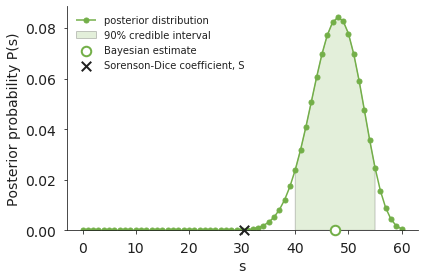

In [21]:
na = 47
nb = 32
nab = 20
pool = 60

pts = pool*2*nab/(na+nb)
ps = p_overlap(na,nb,nab,pool=pool)
lower,shat,upper = credible_interval(na,nb,nab,pool=pool)
x = np.arange(lower,upper+1)
y = np.copy(ps[x])
x = np.append(x,upper)
y = np.append(y,0)
x = np.insert(x,0,lower)
y =np.insert(y,0,0)
er =np.zeros([2,1])
er[0] = shat-lower
er[1] = upper-shat

fig , ax = plt.subplots(1,1,figsize=(6,4))

ax.plot(np.arange(pool+1),ps,
        label='posterior distribution',
        linestyle='-',
        marker='o',
        ms=5,
        color = clr[2])

ax.scatter(shat,0,
           facecolor=[1,1,1],
           edgecolor=clr[2],
           linewidth = 2,
                s=90,
           marker='o',
           label='Bayesian estimate',
          clip_on=False,zorder=100)

ax.fill(x,y,
        facecolor=clr[2],
        edgecolor=[0,0,0],
        alpha=0.2,
        label='90% credible interval',)

ax.scatter(pts,0,
        linewidth=2,
        color=ALMOST_BLACK_V,
        marker='x',
                s=90,
        label='Sorenson-Dice coefficient, S',
       clip_on=False,zorder=100)

ax.set_ylim(bottom=0)
ax.legend()
plt.ylabel('Posterior probability P(s)')
plt.xlabel('s')
finalize(ax)
plt.tight_layout()
if isSaveFigures:
    plt.savefig('figures/fig2.pdf')

In [22]:
import plotly.graph_objects as go
import plotly.tools as tls
from plotly.offline import plot, iplot, init_notebook_mode
from IPython.core.display import display, HTML
init_notebook_mode(connected = True)
config={'showLink': False, 'displayModeBar': False}
 
fig = go.Figure()



fig.add_trace(go.Scatter(x = np.arange(pool+1), y = ps, 
                         mode = 'lines+markers',
                         line=dict(color='rgb(121, 178, 81)'),
                         name = "posterior distribuiton",
                         marker=dict(size=10)))
fig.add_trace(go.Scatter(x = x, y = y,
                         mode = "lines",
                         line=dict(color='rgba(121, 178, 81, 0.1)', width = 1),
                         fill = 'tozeroy',
                         name = "90% credible interval"))
fig.add_trace(go.Scatter(x = [shat], y = [0],
                         mode = 'markers',
                         name = "Bayesian estimate", 
                         marker=dict(size=15,
                                     color="rgb(255,255,255)",
                                     line=dict(width=3,
                                               color='rgb(121, 178, 81)'))))

fig.add_trace(go.Scatter(x = [pts], y = [0],
                         mode = 'markers',
                         marker_symbol = "x",
                         name = "Sorenson-Dice coefficient, S", 
                         marker=dict(size=15,
                                     color="rgb(1,1,1)",)))





fig.update_layout(plot_bgcolor='rgb(255,255,255)',xaxis_title="s",
    yaxis_title='Posterior probability P(s)', legend=dict(x=0.05, y=1))
fig.update_xaxes(ticks = 'outside', showline=True, linecolor='black')
fig.update_yaxes(ticks = 'outside', showline=True, linecolor='black')
plot(fig, filename = 'plotly_figures/fig2.html', config = config)

#ThebeLab
display(HTML('plotly_figures/fig2.html'))

### Figure 3 - Consistency: accuracy improves as sampling increases

In [23]:
pool=60
shat = np.load('shat_60.npy')

In [24]:
reps=4
recovered = np.zeros([6,reps,pool+1])
planted = np.zeros([6,reps,pool+1])
recovered_pts = np.zeros([6,reps,pool+1])
nas = [30,40,50]
for idxa,na in enumerate(nas):
    nb = na
    for s in np.arange(0,pool+1,1):
        for rep in range(3):
            nab = nab_sample(s,na,nb)
            planted[idxa,rep,s] = s
            recovered[idxa,rep,s] = e_overlap(na,nb,nab)
            recovered_pts[idxa,rep,s] = 2*nab/(na+nb)

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all point

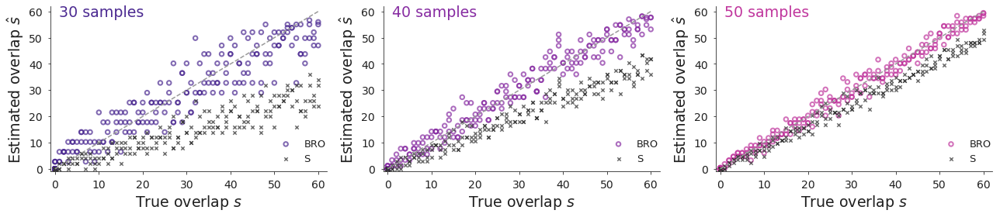

In [25]:
fig,axs = plt.subplots(1,3,figsize=(18,4))
for idxa,na in enumerate(nas):
    ax = axs[idxa]
    ax.plot([0,60],[0,60],color=[0.6,0.6,0.6],
            linestyle='--')
    ax.scatter(planted[idxa,:,:],recovered[idxa,:,:],
               label='BRO'.format(na),
               edgecolor = clr2[idxa],
               facecolor = 'none',
               linewidth = 2,
               s = 30,
               alpha = 0.7,
              )
    ax.scatter(planted[idxa,:,:],pool*recovered_pts[idxa,:,:],
               label='S',
               c = [0.2,0.2,0.2],
               marker = 'x',
               s = 20,
               alpha = 0.7,
              )
    ax.axis([-1, pool+2, -1, pool+2])
    ax.legend()
    ax.set_ylabel('Estimated overlap $\hat s$'.format(na))
    ax.set_xlabel('True overlap $s$')
    finalize(ax)
    leg = ax.legend(loc=[0.8,0.02],frameon=False,fontsize=13)
    ax.yaxis.label.set_size(19)
    ax.xaxis.label.set_size(19)
    ax.text(1, 58, '{} samples'.format(na), fontsize=19,color=clr2[idxa])
    plt.tight_layout()
if isSaveFigures:
    plt.savefig('figures/fig3.pdf'.format(na))

In [28]:
z = np.zeros(60)
d = np.arange(1,60)
fig3 = go.Figure()

colors = ['rgba(129,105,177,0.85)', 'rgba(172,110,191,0.85)','rgba(215,128,193,0.85)']  

planted1 = np.zeros((4,244))
recovered1 = np.zeros((4,244))
recovered_pts1 = np.zeros((4,244))
for index in range(0, 3):
    tmp1 = planted[index,:,:]
    tmp2 = recovered[index,:,:]
    tmp3 = recovered_pts[index,:,:]
    
    planted1[index] = tmp1.flatten()
    recovered1[index] = tmp2.flatten()
    recovered_pts1[index] = tmp3.flatten()

 
fig3.add_trace(go.Scatter(x = d , y = d, line = dict(width=1, dash='dash', color = 'rgb(0,0,0)'), name = 'Reference', showlegend = False))

fig3.add_trace(go.Scatter(x=planted1[0], y=recovered1[0],
                    mode='markers',
                    name = 'BRO',
                  marker=dict(color='rgba(129,105,177,0.85)')))
fig3.add_trace(go.Scatter(x=planted1[0], y=pool*recovered_pts1[0],
                    mode='markers',
                    name = 'S',
                    marker_symbol = "x",
                    marker=dict(color='gray')))
for idxa in [1,2]:
    fig3.add_trace(go.Scatter(x=planted1[idxa], y=recovered1[idxa],
                    mode='markers',
                    name = 'BRO',
                    visible = False,
                    marker=dict(color=colors[idxa])))
    fig3.add_trace(go.Scatter(x=planted1[idxa], y=pool*recovered_pts1[idxa],
                    mode='markers',
                    name = 'S',
                    visible = False,
                    marker_symbol = "x",
                    marker=dict(color='gray')))

fig3.update_layout(
    updatemenus=[
        dict(
            active=0,
            buttons=list([
                dict(label="30 samples",
                     method="update",
                     args=[{"visible": [True,True, True, False, False, False, False]},
                           {"title": ""}]),
                dict(label="40 samples",
                     method="update",
                     args=[{"visible": [True,False, False, True, True, False, False]},
                           {"title": ""
                            }]),
                dict(label="50 samples",
                     method="update",
                     args=[{"visible": [True,False, False,False,False, True, True]},
                           {"title": ""}]),
               
            ]),
                        x=0.2,
                        y = 1.2
        )
    ])

fig3.update_layout(plot_bgcolor='rgb(255,255,255)',xaxis_title="True overlap s",
    yaxis_title='Estimated overlap \u015D', legend=dict(x=.85, y=.1))
fig3.update_xaxes(ticks = 'outside', showline=True, linecolor='black')
fig3.update_yaxes(ticks = 'outside', showline=True, linecolor='black')
plot(fig3, filename = 'plotly_figures/fig3.html', config = config)

#ThebeLab
display(HTML('plotly_figures/fig3.html'))

### Figure 3 - Credible intervals tighten as sampling increases

In [29]:
pool=60
shat = np.load('shat_60.npy')
planted2 = np.zeros([6,6,pool+1])
recovered2 = np.zeros([6,6,pool+1])
lower = np.zeros([6,6,pool+1])
upper = np.zeros([6,6,pool+1])

nas = [30,40,50]
for idxa,na in enumerate(nas):
    nb = na
    idxb = idxa
    for s in np.arange(0,pool+1,1):
        planted2[idxa,idxb,s] = s
        nab = nab_sample(s,na,nb)
        lower[idxa,idxb,s], recovered2[idxa,idxb,s], upper[idxa,idxb,s] = credible_interval(na,nb,nab)
        es = e_overlap(na,nb,nab)
        recovered2[idxa,idxb,s] = es

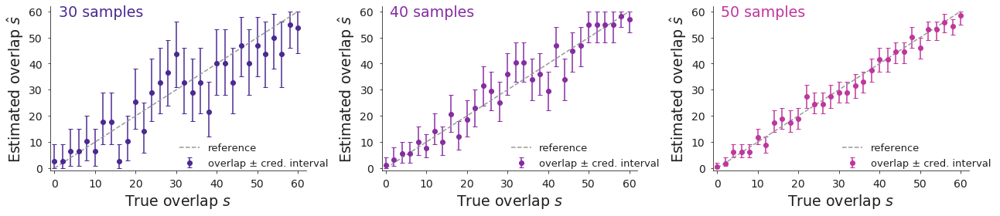

In [30]:
sub = np.arange(0,pool+1,2)
fig,axs = plt.subplots(1,3,figsize=(18,4))
for idxa,na in enumerate(nas):
    ax = axs[idxa]
    ax.errorbar(planted2[idxa,idxa,sub],recovered2[idxa,idxa,sub],
               yerr = [recovered2[idxa,idxa,sub]-lower[idxa,idxa,sub],upper[idxa,idxa,sub]-recovered2[idxa,idxa,sub]],  
               label='overlap ± cred. interval',
               c = clr2[idxa],
                capsize=3,
                fmt='o',
              )
    ax.plot([0,60],[0,60],color=[0.6,0.6,0.6],
            label='reference',
            linestyle='--')
    ax.axis([-1, pool+2, -1, pool+2])
    ax.set_ylabel('Estimated overlap $\hat s$')
    ax.set_xlabel('True overlap $s$')
    finalize(ax)
    leg = ax.legend(loc=[0.49,-0.01],frameon=False,fontsize=13)
    ax.yaxis.label.set_size(19)
    ax.xaxis.label.set_size(19)
    ax.text(1, 58, '{} samples'.format(na), fontsize=19,color=clr2[idxa])
    plt.tight_layout()

if isSaveFigures:
    plt.savefig('figures/fig4.pdf'.format(na))

In [31]:
fig4 = go.Figure()



fig4.add_trace(go.Scatter(x = d , y = d, line = dict(width=1, dash='dash', color = 'rgb(0,0,0)'), name = 'Reference' ))


fig4.add_trace(go.Scatter(x = planted2[0,0,sub], y = recovered2[0,0,sub], 
                         mode = 'markers', 
                         name = "overlap ± cred. interval",
                         line = dict(color = 'rgb(104, 75, 163)'),
                         error_y=dict(
                                    type='data',
                                    symmetric=False,
                                    arrayminus=recovered2[0,0,sub]-lower[0,0,sub],
                                    array=upper[0,0,sub]-recovered2[0,0,sub])))



fig4.add_trace(go.Scatter(x = planted2[1,1,sub], y = recovered2[1,1,sub], mode = 'markers', 
                              name = "overlap ± cred. interval",
                              line = dict(color = 'rgb(137, 47, 163)'),
                              visible = False,
                              error_y=dict(
                                    type='data',
                                    symmetric=False,
                                    arrayminus=recovered2[1,1,sub]-lower[1,1,sub],
                                    array=upper[1,1,sub]-recovered2[1,1,sub])))


fig4.add_trace(go.Scatter(x = planted2[2,2,sub], y = recovered2[2,2,sub], mode = 'markers', 
                              name = "overlap ± cred. interval",
                              line = dict(color = 'rgb(192, 54, 157)'),
                              visible = False,
                              error_y=dict(
                                    type='data',
                                    symmetric=False,
                                    arrayminus=recovered2[2,2,sub]-lower[2,2,sub],
                                    array=upper[2,2,sub]-recovered2[2,2,sub])))

fig4.update_layout(
    updatemenus=[
        dict(
            active=0,
            buttons=list([
                dict(label="30 samples",
                     method="update",
                     args=[{"visible": [True,True, False, False]},
                           {"title": ""}]),
                dict(label="40 samples",
                     method="update",
                     args=[{"visible": [True,False, True, False]},
                           {"title": ""
                            }]),
                dict(label="50 samples",
                     method="update",
                     args=[{"visible": [True, False, False,True]},
                           {"title": ""}]),
               
            ]),
                x=0.2,
                y = 1.2
        )
])

fig4.update_layout(plot_bgcolor='rgb(255,255,255)',xaxis_title="True overlap s",
    yaxis_title='Estimated overlap \u015D', legend=dict(x=.85, y=.1))

fig4.update_xaxes(ticks = 'outside', showline=True, linecolor='black')
fig4.update_yaxes(ticks = 'outside', showline=True, linecolor='black')

plot(fig4, filename = 'plotly_figures/fig4.html', config = config)

#ThebeLab
display(HTML('plotly_figures/fig4.html'))

### Figure 6 -  Decrease in error of estimates as sampling increases

In [32]:
shat = np.load('shat_60.npy')
hist_error = {}
pool = 60
ss = [10,20,30,40,50]
cc = [48,96,144]

In [33]:
for c in cc:
    hist_error[c] = np.zeros([len(ss),pool+1])
    for idx,s in enumerate(ss):
        hist_error[c][idx,:] = np.array(p_shat_given_sc(s,c,shat)[0])

findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


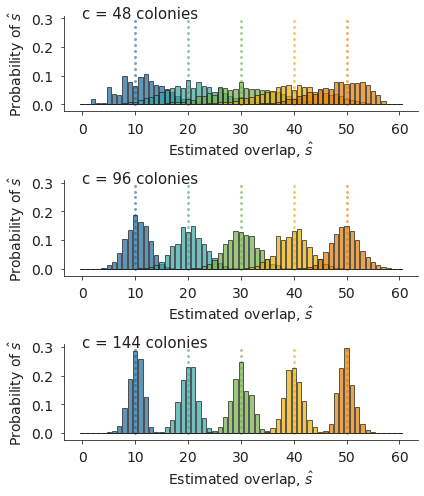

In [34]:
fig,axs = plt.subplots(3,1,figsize=(6,3*2.3))
for idc,c in enumerate(cc):
    ax = axs[idc]
    for idx,s in enumerate(ss):
        ax.scatter(s*np.ones(15),np.linspace(0,0.29,15),4,alpha=0.5, color=clr[idx])
    for idx,s in enumerate(ss):
        ax.bar(np.arange(pool+1),hist_error[c][idx],
              color = clr[idx],
               alpha=0.7,
               ec = ALMOST_BLACK_V
              )
        ax.set_xlabel('Estimated overlap, $\hat{s}$')
        ax.set_ylabel('Probability of $\hat{s}$')
        ax.set_ylim(top=0.31)
        ax.set_yticks(np.array([0.0,0.1,0.2,0.3]))
    ax.text(0, 0.30, 'c = {} colonies'.format(c), fontsize=15)
    plt.tight_layout()
    if idc==0:
        finalize(ax)
        ax.legend(loc=[0.65,0.30],frameon=False)        
    else:
        finalize(ax,ignoreLegend=True)

if isSaveFigures:
    plt.savefig('figures/fig6.pdf'.format(c))

In [35]:
fig5 = go.Figure()
colors = ['rgb(126,169,195)', 'rgb(143,204,204)','rgb(183,214,161)', 'rgb(243,207,113)','rgb(237,181,114)']
c1 = [96,144]

for idx, s in enumerate(ss):
    fig5.add_trace(go.Scatter(x = s*np.ones(15), y =np.linspace(0,0.29,15), mode = 'markers',
                              marker=dict(color=colors[idx]),showlegend=False ))

for idx, s in enumerate(ss):
        fig5.add_trace(go.Bar(x = np.arange(pool+1), y = hist_error[48][idx],marker_color = colors[idx],opacity=0.75,
                          showlegend=False, marker_line_color = "Black", marker_line_width=1.5))    
    
for c in c1:    
    for idx, s in enumerate(ss):
        fig5.add_trace(go.Bar(x = np.arange(pool+1), y = hist_error[c][idx],marker_color = colors[idx],opacity=0.75,
                          showlegend=False, visible = False,marker_line_color = "Black", marker_line_width=1.5))
fig5.update_layout(barmode='overlay', plot_bgcolor='rgb(255,255,255)', height = 400,
                   xaxis_title = 'Estimated overlap, \u015D', yaxis_title = 'Probability of \u015D',
                 
                   updatemenus=[
                    dict(
                        active=0,
                        buttons=list([
                        
                            dict(label="c = 48 colonies",
                             method="update",
                             args=[{"visible": 
                            [True,True,True,True, True,True,True,True,True, True,
                            False, False, False, False,False,False, False, False, False,False]},
                               {"title": ""}]),
                            
                        dict(label="c = 96 colonies",
                             method="update",
                             args=[{"visible": 
                                   [True,True,True,True, True, False, False, False, False,False,
                                    True,True,True,True, True,False, False, False, False,False]},
                               {"title": ""
                                }]),
                        dict(label="c = 144 colonies",
                             method="update",
                             args=[{"visible": 
                                   [True,True,True,True, True, False, False, False, False,False,
                                    False, False, False, False,False,True,True,True,True, True]},
                               {"title": ""}]),
               
            ]),
                        x=0.2,
                        y = 1.2
        )
])





plot(fig5, filename = 'plotly_figures/fig5.html', config = config)

#ThebeLab
display(HTML('plotly_figures/fig5.html'))

# Reprocess past studies

In [36]:
bro = {}
pts = {}
lci = {}

def lenci(na,nb,nab):
    lower,expectation,upper = credible_interval(na,nb,nab,pool=60)
    return upper-lower+1

Amele (Barry et al 2007; using data from SI of Albrecht et al 2010)

In [37]:
dfAme_all = pd.read_excel('data/amele.XLS').replace('-',0)
dfAme = dfAme_all.loc[dfAme_all["source"]=="AMELE"]
dfAme = dfAme.iloc[:,:len(dfAme)]

n = len(dfAme)-1
nab = dfAme.values.astype(int)
na = np.diagonal(nab)
dummy = []
dummz = []
dummp = []
for a in np.arange(n-1):
    for b in np.arange(a+1,n):
        dummy.append(shat[na[a],na[b],nab[a,b]])
        dummz.append(60*2*nab[a,b]/(na[a]+na[b]))
        dummp.append(lenci(na[a],na[b],nab[a,b]))
bro["ame"] = np.array(dummy)
pts["ame"] = np.array(dummz)
lci["ame"] = np.array(dummp)
print("Mean samples per parasite: {:.1f}".format(np.mean(na[:n])))

Mean samples per parasite: 15.6


Kilifi (Bull et al 2007; using data from SI of Albrecht et al 2010)

In [38]:
dfKil = pd.read_excel('data/kilifi.xlsx').replace('-',0)
n = len(dfKil)-1
na = np.array(dfKil.loc[n].apply(lambda x: 60 if x>60 else x)).astype(int)
nab = dfKil.values.astype(int)
dummy = []
dummz = []
dummp = []
# note that this file needs a and b swapped to get the lower diagonal
for a in np.arange(1,n):
    for b in np.arange(0,a):
        dummy.append(shat[na[a],na[b],nab[a,b]])
        dummz.append(60*2*nab[a,b]/(na[a]+na[b])) 
        dummp.append(lenci(na[a],na[b],nab[a,b]))
bro["kilifi"] = np.array(dummy)
pts["kilifi"] = np.array(dummz)
lci["kilifi"] = np.array(dummp)

Brazil (Albrecht 2010)

In [39]:
dfBra = pd.read_excel('data/allbrazil.xlsx').replace('-',0)
n = len(dfBra)-1
na = np.array(dfBra.loc[n].apply(lambda x: 60 if x>60 else x)).astype(int)
nab = dfBra.values.astype(int)
dummy = []
dummz = []
dummp = []
for a in np.arange(n-1):
    for b in np.arange(a+1,n):
        dummy.append(shat[na[a],na[b],nab[a,b]])
        dummz.append(60*2*nab[a,b]/(na[a]+na[b]))
        dummp.append(lenci(na[a],na[b],nab[a,b]))
bro["brazil"] = np.array(dummy)
pts["brazil"] = np.array(dummz)
lci["brazil"] = np.array(dummp)

Ariquemes 1  (Albrecht 2010)

In [40]:
pars = ["113","121","122","123","127","128","153","154"]
dfAri = pd.read_excel('data/ariquemes_1.xlsx').replace('-',0)

n = len(dfAri)-1
na = np.array(dfAri.loc[n].apply(lambda x: 60 if x>60 else x)).astype(int)
nab = dfAri.values.astype(int)

dummy = []
dummz = []
dummp = []

q = np.zeros(np.shape(nab),dtype=int)

for par in pars:
    cols = [col for col in dfAri.columns if par in col]
    ida = list(dfAri.columns).index(cols[0])
    idz = ida+len(cols)
    for a in np.arange(ida,idz):
        for b in np.arange(a+1,idz):
            q[a,b] = 1
            dummy.append(shat[na[a],na[b],nab[a,b]])
            dummz.append(60*2*nab[a,b]/(na[a]+na[b]))
            dummp.append(lenci(na[a],na[b],nab[a,b]))
bro["ari"] = np.array(dummy)
pts["ari"] = np.array(dummz)
lci["ari"] = np.array(dummp)

Ariquemes 2  (Albrecht 2010)

In [41]:
dfAri2 = pd.read_excel('data/ariquemes_2.xlsx').replace('-',0)
n = len(dfAri2)-1
na = np.array(dfAri2.loc[n].apply(lambda x: 60 if x>60 else x)).astype(int)
nab = dfAri2.values.astype(int)
dummy = []
dummz = []
dummp = []
for a in np.arange(n):
    for b in np.arange(a+1,n-1):
        dummy.append(shat[na[a],na[b],nab[a,b]])
        dummz.append(60*2*nab[a,b]/(na[a]+na[b]))
        dummp.append(lenci(na[a],na[b],nab[a,b]))
bro["ari2"] = np.array(dummy)
pts["ari2"] = np.array(dummz)
lci["ari2"] = np.array(dummp)

Wosera (Tessema et al 2014)

In [42]:
dfWos = pd.read_excel('data/tessema_wosera.xlsx')
# compute na, the number of sequences per parasite
na = dfWos.sum().values
# number of parasites
n = len(na)
# compute nab, the number of shared sequences for each pair of parasites
pars = list(dfWos)
nab = np.zeros([n,n],dtype=int)
for a,para in enumerate(pars):
    for b,parb in enumerate(pars):
        nab[a,b] = np.sum((dfWos[para]+dfWos[parb])==2)
dummy = []
dummz = []
dummp = []
for a in np.arange(n):
    for b in np.arange(a+1,n-1):
        dummy.append(shat[na[a],na[b],nab[a,b]])
        dummz.append(60*2*nab[a,b]/(na[a]+na[b]))
        dummp.append(lenci(na[a],na[b],nab[a,b]))
bro["wosera"] = np.array(dummy)
pts["wosera"] = np.array(dummz)
lci["wosera"] = np.array(dummp)

Amele (data from SI of Tessema et al 2014)

In [43]:
dfAme2 = pd.read_excel('data/tessema_amele.xlsx')
# compute na, the number of sequences per parasite
na = dfAme2.sum().values
# number of parasites
n = len(na)
# compute nab, the number of shared sequences for each pair of parasites
pars = list(dfAme2)
nab = np.zeros([n,n],dtype=int)
for a,para in enumerate(pars):
    for b,parb in enumerate(pars):
        nab[a,b] = np.sum((dfAme2[para]+dfAme2[parb])==2)
dummy = []
dummz = []
dummp = []
for a in np.arange(n):
    for b in np.arange(a+1,n-1):
        dummy.append(shat[na[a],na[b],nab[a,b]])
        dummz.append(60*2*nab[a,b]/(na[a]+na[b]))
        dummp.append(lenci(na[a],na[b],nab[a,b]))
bro["amele_tessema"] = np.array(dummy)
pts["amele_tessema"] = np.array(dummz)
lci["amele_tessema"] = np.array(dummp)

Mugil (Tessema et al 2014)

In [44]:
dfMug = pd.read_excel('data/tessema_mugil.xlsx')
# compute na, the number of sequences per parasite
na = dfMug.sum().values
# number of parasites
n = len(na)
# compute nab, the number of shared sequences for each pair of parasites
pars = list(dfMug)
nab = np.zeros([n,n],dtype=int)
for a,para in enumerate(pars):
    for b,parb in enumerate(pars):
        nab[a,b] = np.sum((dfMug[para]+dfMug[parb])==2)
dummy = []
dummz = []
dummp = []
for a in np.arange(n):
    for b in np.arange(a+1,n-1):
        dummy.append(shat[na[a],na[b],nab[a,b]])
        dummz.append(60*2*nab[a,b]/(na[a]+na[b]))
        dummp.append(lenci(na[a],na[b],nab[a,b]))
bro["mugil"] = np.array(dummy)
pts["mugil"] = np.array(dummz)
lci["mugil"] = np.array(dummp)

findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.


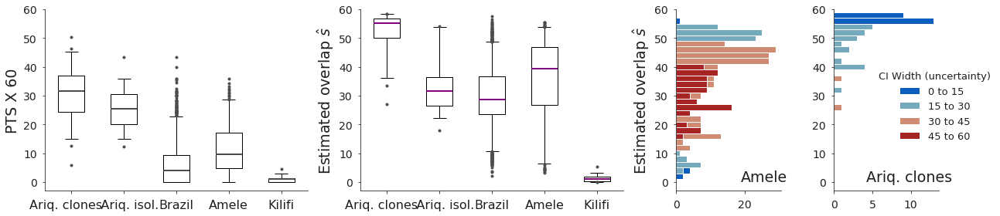

In [45]:
sc = 1
thr = [61,61,15]
samples = ["ari","ari2","brazil","ame","kilifi"]
[pts[x] for x in samples]
colors = [[0.3,0.3,0.3],"purple","red"]
clr3 = pal.cmocean.diverging.Balance_7.mpl_colors
clr3[3] = clr3[4]
clr3[4] = clr3[5]
bands = np.arange(0,46,15)
bands = np.transpose(np.array([bands,bands+15]))

fig = plt.figure(figsize=(18,4))
gs = gridspec.GridSpec(1,6)
ax1 = plt.subplot(gs[0,0:2])
ax2 = plt.subplot(gs[0,2:4])
ax8 = plt.subplot(gs[0,4])
ax9 = plt.subplot(gs[0,5])

axs = [ax1,ax2]
dat = [pts,bro]
for idx,ax in enumerate(axs):
    fp = dict(marker='.',markerfacecolor=[0.3,0.3,0.3],markeredgecolor=[0.3,0.3,0.3])
    mp = dict(linestyle='-', linewidth=2, color=colors[idx])
    ax.boxplot([dat[idx][x][lci[x]<=thr[idx]]/sc for x in samples],whis=[2.5,97.5],flierprops=fp, medianprops=mp)
    if sc == 60:
        ax.set_ylim([-0.05,1.0])
    else:
        ax.set_ylim([-3,60])
    finalize(ax,ignoreLegend=True)
    ax.set_xticklabels(["Ariq. clones   ","   Ariq. isol.","Brazil","Amele","Kilifi"],size=16)
    ax.yaxis.label.set_size(19)
    ax.xaxis.label.set_size(19)
axs[0].set_ylabel('PTS X 60')
axs[1].set_ylabel('Estimated overlap $\hat{s}$')

bxs = [ax8,ax9]

samples = ["ame","ari"]
names = ["Amele", "Ariq. clones"]
ds=2
subs = [ax8,ax9]
for ids,sample in enumerate(samples):
    ax = bxs[ids]
    df = pd.DataFrame(data={"bro":bro[sample], "unc":lci[sample]})
    for idx,b in enumerate(bands):
        h = np.histogram(df.loc[(df["unc"]>b[0]) & (df["unc"]<=b[1]),"bro"].values,
                         bins=(np.arange(0,63,ds)-0.5))[0]
        ax.barh(np.arange(0,61,ds),h,2,color=clr3[idx+1],
                edgecolor='white',label="{} to {}".format(b[0],b[1]))
    if ids==0:
        finalize(ax,ignoreLegend=True)
    else:
        finalize(ax,ignoreLegend=True)
        leg = ax.legend(frameon=False,title="CI Width (uncertainty)",
                        loc=[0.39,0.25],
                        fontsize=13)
        plt.setp(leg.get_title(),fontsize=13)
    ax.yaxis.label.set_size(19)
    ax.xaxis.label.set_size(19)   
    ax.set_ylim(ax1.get_ylim())
    
yscale = ax9.get_ylim()
ax8.set_ylabel(ax2.get_ylabel())
ax8.text(0.62*ax8.get_xlim()[1],0.05*(yscale[1]-yscale[0])+yscale[0],"{}".format(names[0]),size=19)
ax9.text(0.31*ax9.get_xlim()[1],0.05*(yscale[1]-yscale[0])+yscale[0],"{}".format(names[1]),size=19)

fig.tight_layout()
if isSaveFigures:
    plt.savefig('figures/fig5.pdf')

In [46]:
samples2 = ["ari","ari2","brazil","ame","kilifi"]
names = ["Ariq. clones","Ariq. isol.","Brazil","Amele","Kilifi"]
x1 = np.random.randn(500)

fig7 = go.Figure()


for x in np.arange(0,5):
    fig7.add_trace(go.Box(y = dat[0][samples2[x]][lci[samples2[x]]<=thr[0]]/sc,  marker_color = "black", fillcolor = "white", name = names[x],showlegend = False, visible = True ))


for x in np.arange(0,5):
    fig7.add_trace(go.Box(y = dat[1][samples2[x]][lci[samples2[x]]<=thr[1]]/sc,  marker_color = "black", fillcolor = "white", name = names[x],showlegend = False, visible = False ))



fig7.update_layout(plot_bgcolor='rgb(255,255,255)', 
                   updatemenus=[
                    dict(
                        active=0,
                        buttons=list([
                       
                            dict(label="PTS X 60",
                             method="update",
                             args=[{"visible": 
                            [True,True,True,True, True,False, False, False, False, False]},
                               {"title": "",
                                'yaxis': {'title': 'PTS X 60', 'ticks' : 'outside', 'showline': True, 'linecolor': 'black' }}
                                  ]),
                            
                        dict(label=" Estimated overlap \u015D",
                             method="update",
                             args=[{"visible": 
                                  [ False, False, False, False,False,True,True,True,True,True]},
                                  {"title": "",
                                   'yaxis': {'title': 'Estimated overlap \u015D', 'ticks' : 'outside', 'showline': True, 'linecolor': 'black' }}
                                   
                                ]),
                        
               
            ]),
                        x=0.2,
                        y = 1.2
                        
        )
])

fig7.update_xaxes(ticks = 'outside', showline=True, linecolor='black')
fig7.update_yaxes(ticks = 'outside', showline=True, linecolor='black')

plot(fig7, filename = 'plotly_figures/fig7.html', config = config)

#ThebeLab
display(HTML('plotly_figures/fig7.html'))

In [47]:
layout=go.Layout(
        annotations=[
            go.layout.Annotation(
                text='CI Width (uncertanity)',
                align = 'right',
                showarrow=False,
                xref='paper',
                yref='paper',
                x=0.98,
                y=0.55,
                
                
                 
            )
        ]
    )
fig8 = go.Figure(layout = layout)
clrs = ['rgb(12, 94, 190)','rgb(117, 170, 190)', 'rgb(208, 139, 115)','rgb(167, 36, 36)']
bins1 = np.arange(0,63,ds)-0.5
for ids,sample in enumerate(samples):
    for idx,b in enumerate(bands):
        df = pd.DataFrame(data={"bro":bro[sample], "unc":lci[sample]})
        counts, bins = np.histogram(df.loc[(df["unc"]>b[0]) & (df["unc"]<=b[1]),"bro"].values, bins = bins1)
        if ids == 0: 
            fig8.add_trace(go.Bar(visible = True, y=bins, x = counts, orientation='h',width = 2,
                                  marker_color=clrs[idx], name ="{} to {}".format(b[0],b[1])))
        else:
            fig8.add_trace(go.Bar(visible = False, y=bins, x = counts, orientation='h',width = 2,
                                  marker_color=clrs[idx], name ="{} to {}".format(b[0],b[1])))

            
fig8.update_layout(plot_bgcolor='rgb(255,255,255)', 
                   updatemenus=[
                    dict(
                        active=0,
                        buttons=list([
                       
                            dict(label="Amele",
                             method="update",
                             args=[{"visible": 
                            [True,True,True,True,False, False, False, False]},
                               {"title": "",
                                 }
                                  ]),
                            
                        dict(label=" Ariq. clones",
                             method="update",
                             args=[{"visible": 
                                  [False, False, False,False,True,True,True,True]},
                                   {"title": "",
                                    }
                                   
                                ]),
                        
               
            ]),
                        x=0.95,
                        y = 0.2
                        
        )
                    ],legend=dict(x=.75, y=.35)
                   
                  )            
            
            
fig8.update_xaxes(ticks = 'outside', showline=True, linecolor='black')
fig8.update_yaxes(ticks = 'outside', showline=True, linecolor='black')            
            
            

plot(fig8, filename = 'plotly_figures/fig8.html', config = config)

#ThebeLab
display(HTML('plotly_figures/fig8.html'))

## Supplemental Figure: What if $n_a \neq n_b$ ?

Reviewers made a good suggestion to show the case when $n_a$ is much larger than $n_b$. What happens in this case? 

They also asked what happens when the population sizes are unequal, and not 60. 

We therefore consider conditions: 
- 1 - $n_a = n_b = 40$
- 2 - $n_a=10, n_b=40$
- A - total repertoire sizes are each 60
- B - one repertoire of size 60 and the other of size 120

We show plots for 1A, 1B, 2A, 2B to show the various combinations.

In [46]:
reps=2
pool_a = 60
recovered = np.zeros([4,reps,pool_a+1])
planted = np.zeros([4,reps,pool_a+1])
recovered_pts = np.zeros([4,reps,pool_a+1])

# 1A
na,nb = 40,40
pool_b = 60
case = 0
for s in np.arange(0,pool_a+1,1):
    for rep in range(reps):
        nab = nab_sample_unequal(s,na,nb,pool_a,pool_b)
        planted[case,rep,s] = s
        recovered[case,rep,s] = e_overlap_unequal(na,nb,nab,pool_a,pool_b)
        recovered_pts[case,rep,s] = 2*nab/(na+nb)
# 1B
na,nb = 40,40
pool_b = 120
case = 1
for s in np.arange(0,pool_a+1,1):
    for rep in range(reps):
        nab = nab_sample_unequal(s,na,nb,pool_a,pool_b)
        planted[case,rep,s] = s
        recovered[case,rep,s] = e_overlap_unequal(na,nb,nab,pool_a,pool_b)
        recovered_pts[case,rep,s] = 2*nab/(na+nb)
# 2A
na,nb = 10,40
pool_b = 60
case = 2
for s in np.arange(0,pool_a+1,1):
    for rep in range(reps):
        nab = nab_sample_unequal(s,na,nb,pool_a,pool_b)
        planted[case,rep,s] = s
        recovered[case,rep,s] = e_overlap_unequal(na,nb,nab,pool_a,pool_b)
        recovered_pts[case,rep,s] = 2*nab/(na+nb)
# 2B
na,nb = 10,40
pool_b = 120
case = 3
for s in np.arange(0,pool_a+1,1):
    for rep in range(reps):
        nab = nab_sample_unequal(s,na,nb,pool_a,pool_b)
        planted[case,rep,s] = s
        recovered[case,rep,s] = e_overlap_unequal(na,nb,nab,pool_a,pool_b)
        recovered_pts[case,rep,s] = 2*nab/(na+nb)

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which shoul

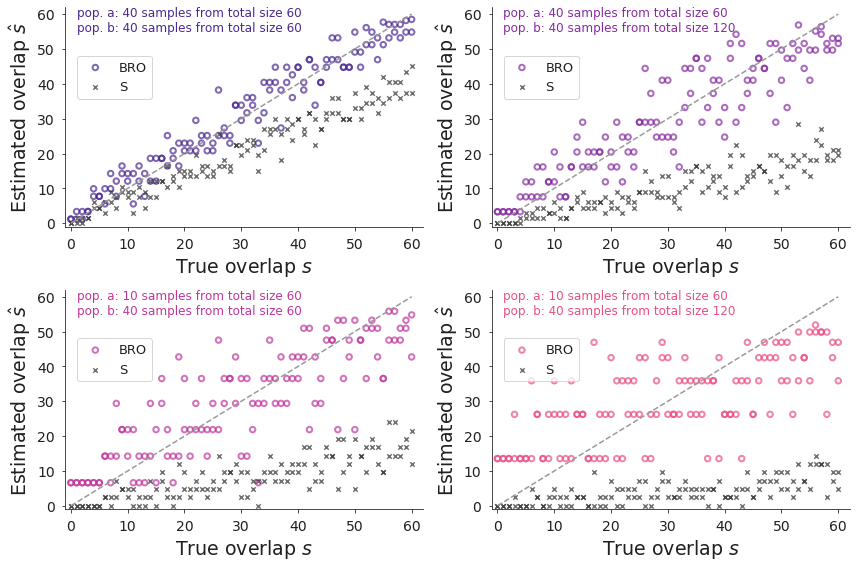

In [47]:
fig,axs = plt.subplots(2,2,figsize=(6*2,4*2))
for case in np.arange(4):
    if case==0:
        ax = axs[0,0]
    elif case==1:
        ax = axs[0,1]
    elif case==2:
        ax = axs[1,0]
    elif case==3:
        ax = axs[1,1]
    ax.plot([0,60],[0,60],color=[0.6,0.6,0.6],
                linestyle='--')
    ax.scatter(planted[case,:,:],recovered[case,:,:],
               label='BRO'.format(na),
               edgecolor = clr2[case],
               facecolor = 'none',
               linewidth = 2,
               s = 30,
               alpha = 0.7,
              )
    ax.scatter(planted[case,:,:],pool_a*recovered_pts[case,:,:],
               label='S',
               c = [0.2,0.2,0.2],
               marker = 'x',
               s = 20,
               alpha = 0.7,
              )
    ax.axis([-1, pool_a+2, -1, pool_a+2])
    ax.legend()
    ax.set_ylabel('Estimated overlap $\hat s$'.format(na))
    ax.set_xlabel('True overlap $s$')
    finalize(ax)
    leg = ax.legend(loc=[2/60,35/60],frameon=True,fontsize=13)
    ax.yaxis.label.set_size(19)
    ax.xaxis.label.set_size(19)
    if case==0:
        ax.text(1, 55, 'pop. a: {} samples from total size {}\npop. b: {} samples from total size {}'
                .format(40,60,40,60), fontsize=12,color=clr2[case])
    elif case==1:
        ax.text(1, 55, 'pop. a: {} samples from total size {}\npop. b: {} samples from total size {}'
                .format(40,60,40,120), fontsize=12,color=clr2[case])
    elif case==2:
        ax.text(1, 55, 'pop. a: {} samples from total size {}\npop. b: {} samples from total size {}'
                .format(10,60,40,60), fontsize=12,color=clr2[case])
    elif case==3:
        ax.text(1, 55, 'pop. a: {} samples from total size {}\npop. b: {} samples from total size {}'
                .format(10,60,40,120), fontsize=12,color=clr2[case])
    plt.tight_layout()

if isSaveFigures:
    plt.savefig('figures/suppfig_1_unequal_samples_and_sizes.pdf'.format(na))

In [48]:
planted2 = np.zeros((4,122))
recovered2 = np.zeros((4,122))
recovered_pts2 = np.zeros((4,122))
for index in range(0, 4):
    tmp11 = planted[index,:,:]
    tmp22 = recovered[index,:,:]
    tmp33 = recovered_pts[index,:,:]
    
    planted2[index] = tmp11.flatten()
    recovered2[index] = tmp22.flatten()
    recovered_pts2[index] = tmp33.flatten()

colors = ['rgba(129,105,177,0.7)', 'rgba(172,110,191,0.7)','rgba(215,128,193,0.7)', 'rgba(240,133,172,0.7)']  
fig6 = go.Figure()

fig6.add_trace(go.Scatter(x = d, y = z, line = dict(color = 'rgb(0,0,0)'),showlegend=False))
fig6.add_trace(go.Scatter(x = z, y = d, line = dict(color = 'rgb(0,0,0)'),showlegend=False))
fig6.add_trace(go.Scatter(x = d , y = d, line = dict(width=1, dash='dash'), name = 'Reference', showlegend = False ))


for case in np.arange(4):
    fig6.add_trace(go.Scatter(x=planted2[case], y=recovered2[case],
                    mode='markers',
                    visible = False,
                    name = 'BRO',
                  marker=dict(color=colors[case])))
    fig6.add_trace(go.Scatter(x=planted2[case], y=pool*recovered_pts2[case],
                    mode='markers',
                    visible = False,
                    name = 'S',
                    marker_symbol = "x",
                    marker=dict(color='rgba(115, 115, 115, 0.7)')))

    
    
fig6.update_layout(
    updatemenus=[
        dict(
            active=0,
            buttons=list([
                dict(label="Select Here",
                     method="update",
                     args=[{"visible": [True,True,True,False, False, False, False, False, False,False,False]},
                           {"title": ""}]),
                
                dict(label="a = 40x60 , b = 40x60",
                     method="update",
                     args=[{"visible": [True,True,True,True, True, False, False, False, False,False,False]},
                           {"title": "pop. a: 40 samples from total size 60, pop. b: 40 samples from total size 60"}]),
                dict(label="a = 40x60 , b = 40x120",
                     method="update",
                     args=[{"visible": [True,True,True,False, False, True, True, False, False,False,False]},
                           {"title": "pop. a: 40 samples from total size 60, pop. b: 40 samples from total size 120"
                            }]),
                dict(label="a = 10x60 , b = 40x60",
                     method="update",
                     args=[{"visible": [True,True,True,False, False,False,False, True, True,False,False]},
                           {"title": "pop. a: 10 samples from total size 60, pop. b: 40 samples from total size 60"}]),
                dict(label="a = 10x60 , b = 40x120",
                     method="update",
                     args=[{"visible": [True,True,True,False, False,False,False,False,False,True,True]},
                           {"title": "pop. a: 10 samples from total size 60, pop. b: 40 samples from total size 120"}]),
               
            ]),
        )
    ])
fig6.update_layout(plot_bgcolor='rgb(255,255,255)',xaxis_title="True overlap s",
    yaxis_title='Estimated overlap s', width = 800, height = 500, legend=dict(x=.1, y=.65, bordercolor = 'Black',
                                                                             borderwidth = 2))
plot(fig6, filename = 'plotly_figures/fig6.html', config = config)

#ThebeLab
display(HTML('plotly_figures/fig6.html'))

# Unpublished Notes: Uncertainty for empirical overlap studies 

### Wosera, Mugil, Amele

No handles with labels found to put in legend.
No handles with labels found to put in legend.


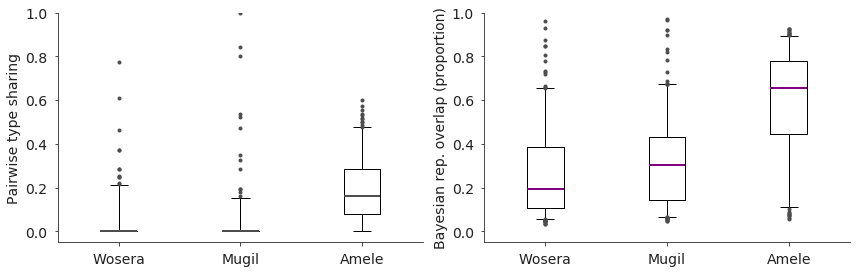

In [49]:
sc = 60
thr = [61,61,15]
samples = ["wosera","mugil","amele_tessema"]
[pts[x] for x in samples]
colors = [[0.3,0.3,0.3],"purple","red"]

fig,axs = plt.subplots(1,2,figsize=(12,4))
dat = [pts,bro,bro]
titles = ["PTS", "BRO"]
for idx,ax in enumerate(axs):
    fp = dict(marker='.',markerfacecolor=[0.3,0.3,0.3],markeredgecolor=[0.3,0.3,0.3])
    mp = dict(linestyle='-', linewidth=2, color=colors[idx])
    ax.boxplot([dat[idx][x][lci[x]<=thr[idx]]/sc for x in samples],whis=[2.5,97.5],flierprops=fp, medianprops=mp)
#     ax.violinplot([dat[idx][x][lci[x]<61]/sc for x in samples])
    if sc == 60:
        ax.set_ylim([-0.05,1.0])
    else:
        ax.set_ylim([0,60/sc])
    ax.set_xticklabels(["Wosera","Mugil","Amele"])
    finalize(ax)
axs[0].set_ylabel('Pairwise type sharing')
axs[1].set_ylabel('Bayesian rep. overlap (proportion)')
plt.tight_layout()

if isSaveFigures:
    plt.savefig('figures/tessema2015remake.pdf')

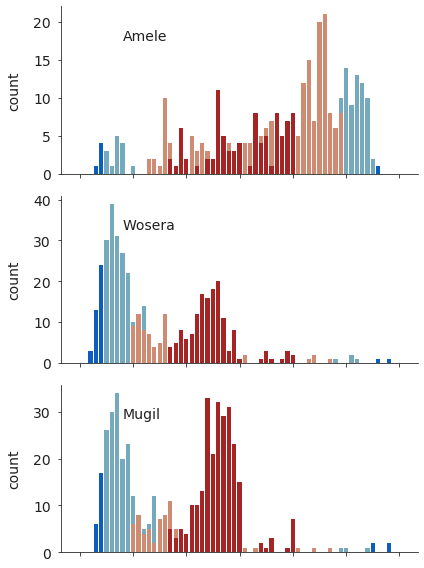

In [50]:
clr3 = pal.cmocean.diverging.Balance_7.mpl_colors
clr3[3] = clr3[4]
clr3[4] = clr3[5]
bands = np.arange(0,46,15)
bands = np.transpose(np.array([bands,bands+15]))
# samples = ["ari","ari2","brazil","ame","kilifi","thies"]
# names = ["Ariquemes clones", "Ariquemes isolates", "Brazil", "Amele", "Kilifi","Thies"]
samples = ["amele_tessema","wosera","mugil"]
names = ["Amele", "Wosera","Mugil"]
fig,axs = plt.subplots(3,1,figsize=(6,8))
for ids,sample in enumerate(samples):
    ax = axs[ids]
    df = pd.DataFrame(data={"bro":bro[sample], "unc":lci[sample]})
    binz = np.arange(0,61)
    for idx,b in enumerate(bands):
        h = np.histogram(df.loc[(df["unc"]>b[0]) & (df["unc"]<=b[1]),"bro"].values,bins=(np.arange(0,62)-0.5))[0]
        ax.bar(binz,h,color=clr3[idx+1],label=str(b))
#         ax.bar(binz,h,color=clr[2],label=str(b))
    yscale = ax.get_ylim()
    ax.text(8,0.8*yscale[1],"{}".format(names[ids]),size=14)
    if ids!=3:
        finalize(ax,ignoreLegend=True)
        ax.set_xticklabels([])
        ax.set_ylabel('count',labelpad=12)
    else:
        finalize(ax,ignoreLegend=True)
        leg = ax.legend(frameon=False,title="Uncertainty",loc=[0.8,0.25])
        ax.set_xlabel("Bayesian Repertoire Overlap")
        ax.set_ylabel('count')
plt.tight_layout()

if isSaveFigures:
    plt.savefig('figures/uncertainty_barcharts.pdf'.format(sample))

# Unpublished notes: Distributions of errors from PCR vs c

In [51]:
hist_error_2 = {}
ss = [30]
pool = 60
cc = [48,96,144,192]

In [52]:
for c in cc:
    hist_error_2[c] = np.zeros([len(ss),pool+1])
    for idx,s in enumerate(ss):
        hist_error_2[c][idx,:] = np.array(p_shat_given_sc(s,c,shat)[0])

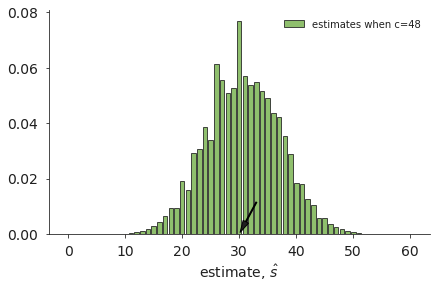

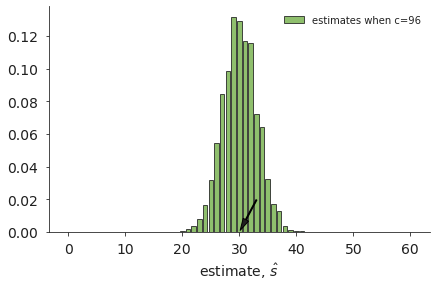

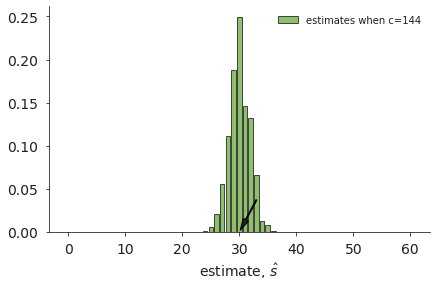

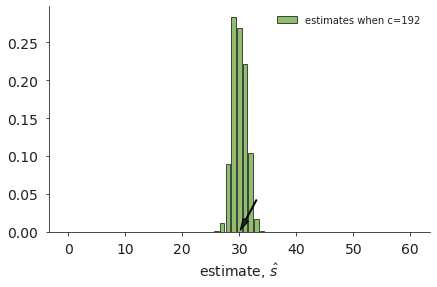

In [53]:
for c in cc:
    fig,ax = plt.subplots(1,1,figsize=(6,4))
    for idx,s in enumerate(ss):
        ax.bar(np.arange(pool+1),hist_error_2[c][idx],
              color = clr[2],
               label='estimates when c={}'.format(c),
               alpha = 0.8,
               ec = ALMOST_BLACK_V
              )
        plt.xlabel('estimate, $\hat{s}$')
        scx = ax.get_xlim()[1]
        scy = ax.get_ylim()[1]
    for idx,s in enumerate(ss):
        ax.annotate("", xy=(s, 0), xytext=(s+0.05*scx, 0.15*scy),
            arrowprops=dict(
            facecolor=ALMOST_BLACK_V,
                width=1,
            headwidth=6,
            shrink=0.05))
    plt.tight_layout()
    finalize(ax)
    plt.show()
    if isSaveFigures:
        plt.savefig('figures/s_hat_PCR_s{}_c{}.pdf'.format(s,c))

# Unpublished notes: fix PTS and vary parameters

We know that we have
$$PTS = \frac{2 n_{ab}}{n_a + n_b}$$

If we fix $PTS=0.5$, then we have $\frac{1}{2} = \frac{2 n_{ab}}{n_a + n_b}$ and this means that 
$$n_a + n_b = 4 n_{ab}$$

In [54]:
fixedpts_nab = 20
for na in np.arange(20,41):
    print(shat[na,80-na,20])

58.18181818181819
56.536707056307925
55.058333333333344
53.72813559322035
52.53050397877985
51.452241715399595
50.48214285714286
49.610658307210024
48.829629629629636
48.132075471698116
47.51201923076923
46.96434937611407
46.484705882352934
46.069387755102035
45.715277777777786
45.41978148361126
45.180778032036635
44.9965811965812
44.865909090909085
44.78786159954625
44.76190476190476
